<a href="https://colab.research.google.com/github/lucadra/MappaMilanoElezioni_250922/blob/main/Mappa_Dati_Elettorali_Politiche_Milano_2022.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The following datasets are used in this notebook:

*   Stradario Elettorale ([Comune di Milano, Settore Satistica](https://siel.comune.milano.it/))
*   Election results ([Comune di Milano, Settore Satistica](https://siel.comune.milano.it/))
*   Adresses's Coordinates ([Portale Open Data del Comune di Milano](https://dati.comune.milano.it/dataset/ds634-numeri-civici-coordinate))
*   Milan's city limits ([Portale Open Data della Regione Lombardia](https://www.dati.lombardia.it/Government/CITTA-METROPOLITANA-MILANO-Confini-Comuni-e-Zone-O/cnun-cyrz))

# Install Necessary Dependencies

In [75]:
!pip install pandas fiona shapely pyproj rtree mapclassify
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [78]:
import numpy as np
import pandas as pd 
import geopandas as gpd 
from tqdm import tqdm
from functools import reduce
from shapely import geometry
from shapely import wkt
import os 
import time
import json
import folium
from shapely.geometry import Polygon, MultiPolygon
pd.set_option('display.max_columns', None)

# Import data

### Stradario
In Italy, the smallest unit of measure for electoral data is the "Sezione Elettorale". A *Sezione Elettorale* can be tought of as a subset of the U.S.'s Congressional District: a group of *Sezioni Elettorali* belong to an Electoral District, representatives are elected based on Electoral District results rather than *Sezione Elettorale* results. In short, the reason for their existence is to improve logistic efficency rather than representation.

A citizen's *Sezione Elettorale* is determined by their address, the document listing all *Sezioni Elettorali* and the addresses belonging to them is the *Stradario Elettorale*

In [4]:
stradario = pd.read_csv("/content/drive/MyDrive/mappa_dati_elettorali_milano/stradario_elettorale.csv", delimiter=";")
stradario["Barrato"] = stradario["Barrato"].str.replace("^0+", "").str.strip().replace(" ", np.nan)
stradario.fillna(0, inplace=True)
stradario.drop(columns='Sessione', inplace=True)
stradario

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  


,CodVia,Area,Via,Civico,Barrato,Sezione,Municipio,CollSen_UNI,CollCam_UNI
0,4377,VIA,8 OTTOBRE 2001,12,0,916,4,3,8
1,3123,VIA,A.DEL SARTO,1,0,665,3,3,7
2,3123,VIA,A.DEL SARTO,3,0,665,3,3,7
3,3123,VIA,A.DEL SARTO,4,0,665,3,3,7
4,3123,VIA,A.DEL SARTO,5,0,665,3,3,7
...,...,...,...,...,...,...,...,...,...
51089,6318,VIA,ZURIGO,24,0,394,7,3,8
51090,6318,VIA,ZURIGO,24,4,394,7,3,8
51091,6318,VIA,ZURIGO,25,0,1412,6,3,8
51092,6318,VIA,ZURIGO,28,0,539,7,3,8


### Coordinates
The dataframe contains `[lat, lon]` coordinates for every address in the City of Milan

In [5]:
coordinate = pd.read_csv("/content/drive/MyDrive/mappa_dati_elettorali_milano/coordinate_civici.csv", delimiter=";")
coordinate['BARRA'].fillna(coordinate['LETTERA'], inplace = True)
coordinate["BARRA"] = coordinate["BARRA"].str.replace("^0+", "").str.strip().replace("", np.nan)
coordinate.sort_values(by=['NUMEROCOMPLETO', 'CODICE_VIA'], inplace=True)
coordinate.fillna(0, inplace=True)
coordinate

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: The default value of regex will change from True to False in a future version.
  This is separate from the ipykernel package so we can avoid doing imports until


,CODICE_VIA,NUMERO,LETTERA,BARRA,BARRA2,NUMEROCOMPLETO,MUNICIPIO,RESIDENZIALE,STATOCIVICO,DATA_APPLICAZIONE,DATA_ATTIVAZIONE,DATA_SOPPRESSIONE,ULTIMA_MODIFICA,GAUSSB_X,GAUSSB_Y,WGS84_X,WGS84_Y,WEBMERC_X,WEBMERC_Y,DATA_MODFINE,IDMASTER,PASSOCARRAIO,LIVELLO,STATOVIA,TIPO,DENOMINAZIONE,DATA_INTITOLAZIONE,ANNO_SOPPRESSIONE,DESCRITTIVO,ANNCSU,OPENSTREETMAP,PROGANNCSU,ID_NIL,NIL,LONG_WGS84,LAT_WGS84,Location
155,97,1,0,0,0,1,1,1.0,Applicato,20041231.0,20041231,0.0,20080619,"1515499,6029","5034753,0898","515471,596","5034733,0725","1023906,9498","5695177,0144",0,32,0.0,A RASO (LIVELLO STRADALE),Intitolata,Largo,TOSCANINI ARTURO,0.0,0,ARTURO TOSCANINI,ARTURO TOSCANINI,ARTURO TOSCANINI,0.0,1.0,DUOMO,9.197913,45.465953,"(45.4659532843, 9.19791262522)"
165,98,1,0,0,0,1,1,0.0,Applicato,20180614.0,20180614,0.0,20211102,"1515203,7975","5034697,0635","515175,7964","5034677,046","1023485,5413","5695097,9997",0,186791,0.0,A RASO (LIVELLO STRADALE),Intitolata,Piazza,LIBERTY (DEL),0.0,0,DEL LIBERTY,DEL LIBERTY,LIBERTY,0.0,1.0,DUOMO,9.194127,45.465455,"(45.4654554752, 9.19412704825)"
170,101,1,0,0,0,1,1,1.0,Applicato,20041231.0,20041231,0.0,20080619,"1514626,0803","5035170,4682","514598,0881","5035150,4393","1022664,4635","5695776,3173",0,41,0.0,A RASO (LIVELLO STRADALE),Intitolata,Vicolo,CIOVASSO,0.0,0,CIOVASSO,DI VIA CIOVASSO,CIOVASSO,0.0,2.0,BRERA,9.186751,45.469729,"(45.4697288748, 9.18675118088)"
199,103,1,0,0,0,1,1,1.0,Applicato,20041231.0,20041231,0.0,20191118,"1514815,119","5034638,0604","514787,1255","5034618,0424","1022931,8847","5695015,0257",0,43,0.0,A RASO (LIVELLO STRADALE),Intitolata,Via,PELLICO SILVIO,0.0,0,SILVIO PELLICO,SILVIO PELLICO,SILVIO PELLICO,0.0,1.0,DUOMO,9.189153,45.464933,"(45.4649327169, 9.18915346639)"
230,105,1,0,0,0,1,1,1.0,Applicato,20041231.0,20041231,0.0,20080619,"1514795,9001","5034705,2416","514767,9066","5034685,2222","1022904,7425","5695111,0696",0,55,0.0,A RASO (LIVELLO STRADALE),Intitolata,Via,GROSSI TOMMASO,0.0,0,TOMMASO GROSSI,TOMMASO GROSSI,TOMMASO GROSSI,0.0,1.0,DUOMO,9.188910,45.465538,"(45.4655378186, 9.18890964386)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31359,3339,9,0,0,P03,9P03,4,0.0,Iter in corso,0.0,20191015,0.0,20201016,"1517661,2266","5033400,496","517633,1845","5033380,5133","1026979,6232","5693236,675",0,230567,1.0,A RASO (LIVELLO STRADALE),Intitolata,Via,CADIBONA,0.0,0,CADIBONA,CADIBONA,CADIBONA,0.0,29.0,ORTOMERCATO,9.225515,45.453727,"(45.4537274689, 9.22551492)"
32065,4006,9,0,0,P03,9P03,4,0.0,Applicato,20211021.0,20151116,0.0,20211021,"1517505,1149","5032607,4119","517477,079","5032587,4435","1026754,2403","5692104,5465",0,169840,1.0,A RASO (LIVELLO STRADALE),Intitolata,Via,VERNE GIULIO,19720614.0,0,GIULIO VERNE,GIULIO VERNE,GIULIO VERNE,0.0,28.0,UMBRIA - MOLISE - CALVAIRATE,9.223490,45.446593,"(45.4465928561, 9.22349027096)"
31360,3339,9,0,0,P04,9P04,4,0.0,Iter in corso,0.0,20191015,0.0,20201016,"1517682,9625","5033400,9083","517654,92","5033380,9256","1027010,5692","5693237,1768",0,230568,1.0,A RASO (LIVELLO STRADALE),Intitolata,Via,CADIBONA,0.0,0,CADIBONA,CADIBONA,CADIBONA,0.0,29.0,ORTOMERCATO,9.225793,45.453731,"(45.453730631, 9.22579291265)"
32066,4006,9,0,0,P04,9P04,4,0.0,Applicato,20211021.0,20151116,0.0,20211021,"1517515,654","5032612,211","517487,618","5032592,2425","1026769,2615","5692111,3588",0,169841,1.0,A RASO (LIVELLO STRADALE),Intitolata,Via,VERNE GIULIO,19720614.0,0,GIULIO VERNE,GIULIO VERNE,GIULIO VERNE,0.0,28.0,UMBRIA - MOLISE - CALVAIRATE,9.223625,45.446636,"(45.4466357895, 9.2236252087)"


### Merging the datasets

We're going to merge the dataframes using a triplet of common values: street id, the address number, and the eventual alphabetic part of the address number

Check if there are unmatched values

In [55]:
not_in_df = [ item for item in list(stradario.Barrato.unique()) if item not in list(coordinate.BARRA.unique())]
not_in_df

['V', '1A']

Accept the fact that some values will be unmatched 😞

Remove duplicates because the coordinate dataframe includes "candidate addresses" with proposed values for the new address in the column "BARRA2".

In [7]:
coordinate.drop_duplicates(subset=['CODICE_VIA', 'NUMERO', 'BARRA'], keep='first', inplace=True)

,CODICE_VIA,NUMERO,LETTERA,BARRA,BARRA2,NUMEROCOMPLETO,MUNICIPIO,RESIDENZIALE,STATOCIVICO,DATA_APPLICAZIONE,DATA_ATTIVAZIONE,DATA_SOPPRESSIONE,ULTIMA_MODIFICA,GAUSSB_X,GAUSSB_Y,WGS84_X,WGS84_Y,WEBMERC_X,WEBMERC_Y,DATA_MODFINE,IDMASTER,PASSOCARRAIO,LIVELLO,STATOVIA,TIPO,DENOMINAZIONE,DATA_INTITOLAZIONE,ANNO_SOPPRESSIONE,DESCRITTIVO,ANNCSU,OPENSTREETMAP,PROGANNCSU,ID_NIL,NIL,LONG_WGS84,LAT_WGS84,Location
155,97,1,0,0,0,1,1,1.0,Applicato,20041231.0,20041231,0.0,20080619,"1515499,6029","5034753,0898","515471,596","5034733,0725","1023906,9498","5695177,0144",0,32,0.0,A RASO (LIVELLO STRADALE),Intitolata,Largo,TOSCANINI ARTURO,0.0,0,ARTURO TOSCANINI,ARTURO TOSCANINI,ARTURO TOSCANINI,0.0,1.0,DUOMO,9.197913,45.465953,"(45.4659532843, 9.19791262522)"
165,98,1,0,0,0,1,1,0.0,Applicato,20180614.0,20180614,0.0,20211102,"1515203,7975","5034697,0635","515175,7964","5034677,046","1023485,5413","5695097,9997",0,186791,0.0,A RASO (LIVELLO STRADALE),Intitolata,Piazza,LIBERTY (DEL),0.0,0,DEL LIBERTY,DEL LIBERTY,LIBERTY,0.0,1.0,DUOMO,9.194127,45.465455,"(45.4654554752, 9.19412704825)"
170,101,1,0,0,0,1,1,1.0,Applicato,20041231.0,20041231,0.0,20080619,"1514626,0803","5035170,4682","514598,0881","5035150,4393","1022664,4635","5695776,3173",0,41,0.0,A RASO (LIVELLO STRADALE),Intitolata,Vicolo,CIOVASSO,0.0,0,CIOVASSO,DI VIA CIOVASSO,CIOVASSO,0.0,2.0,BRERA,9.186751,45.469729,"(45.4697288748, 9.18675118088)"
199,103,1,0,0,0,1,1,1.0,Applicato,20041231.0,20041231,0.0,20191118,"1514815,119","5034638,0604","514787,1255","5034618,0424","1022931,8847","5695015,0257",0,43,0.0,A RASO (LIVELLO STRADALE),Intitolata,Via,PELLICO SILVIO,0.0,0,SILVIO PELLICO,SILVIO PELLICO,SILVIO PELLICO,0.0,1.0,DUOMO,9.189153,45.464933,"(45.4649327169, 9.18915346639)"
230,105,1,0,0,0,1,1,1.0,Applicato,20041231.0,20041231,0.0,20080619,"1514795,9001","5034705,2416","514767,9066","5034685,2222","1022904,7425","5695111,0696",0,55,0.0,A RASO (LIVELLO STRADALE),Intitolata,Via,GROSSI TOMMASO,0.0,0,TOMMASO GROSSI,TOMMASO GROSSI,TOMMASO GROSSI,0.0,1.0,DUOMO,9.188910,45.465538,"(45.4655378186, 9.18890964386)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58347,7233,9,0,0,P01,9P01,8,0.0,Iter in corso,0.0,20170125,0.0,20201029,"1513918,6522","5036756,9364","513890,6668","5036736,8746","1021662,0311","5698045,6037",0,190214,1.0,A RASO (LIVELLO STRADALE),Intitolata,Piazzale,CIMITERO MONUMENTALE,0.0,0,CIMITERO MONUMENTALE,CIMITERO MONUMENTALE,CIMITERO MONUMENTALE,0.0,69.0,SARPI,9.177746,45.484023,"(45.48402301994705, 9.177746177451509)"
58888,7275,9,0,0,P01,9P01,8,0.0,Applicato,20160907.0,20160331,0.0,20181004,"1511681,7332","5038391,5721","511653,7832","5038371,47","1018480,0284","5700388,5213",0,172368,1.0,A RASO (LIVELLO STRADALE),Intitolata,Via,MANTEGAZZA PAOLO,0.0,0,PAOLO MANTEGAZZA,PAOLO MANTEGAZZA,PAOLO MANTEGAZZA,0.0,71.0,VILLAPIZZONE - CAGNOLA - BOLDINASCO,9.149162,45.498777,"(45.4987771608, 9.14916176082)"
59463,7338,9,0,0,P01,9P01,8,0.0,Iter in corso,0.0,20210603,0.0,20210603,"1511003,9353","5039967,8479","510975,9915","5039947,7132","1017518,2254","5702643,8511",0,253121,1.0,A RASO (LIVELLO STRADALE),Intitolata,Via,GRAF ARTURO,19691022.0,0,ARTURO GRAF,ARTURO GRAF,ARTURO GRAF,0.0,76.0,QUARTO OGGIARO - VIALBA - MUSOCCO,9.140522,45.512976,"(45.512976080778145, 9.14052173764969)"
59655,7346,9,0,0,P01,9P01,9,0.0,Iter in corso,0.0,20210218,0.0,20210218,"1512120,2374","5040507,3108","512092,2703","5040487,1705","1019110,6048","5703412,3166",0,249707,1.0,A RASO (LIVELLO STRADALE),Intitolata,Via,EL ALAMEIN,0.0,0,EL ALAMEIN,EL ALAMEIN,EL ALAMEIN,0.0,81.0,BOVISASCA,9.154826,45.517813,"(45.517813304371145, 9.154826325415417)"


In [9]:
stradario.shape[0], coordinate.shape[0]

(51094, 54484)

In [59]:
(coordinate.shape[0]-stradario.shape[0])/coordinate.shape[0]

0.06222010131414727

Confronting the *Stradario* Dataframe and the Coordinates Dataframe we notice the former is about 6% smaller. This could be due to some addresses not belonging to any sezione elettorale as they belong to offices or industrial areas. 

The mismatch could also be explained by the stochastic nature of italian local policies and programmes

# Merging the two datasets


In [12]:
stradario_coordinate = stradario.merge(coordinate, how="left", left_on=['CodVia', 'Civico', 'Barrato'], right_on=['CODICE_VIA', 'NUMERO', 'BARRA'])
stradario_coordinate.dropna(subset=['CODICE_VIA'], how='any', inplace=True)
stradario_coordinate.drop(columns=['CODICE_VIA','NUMERO','LETTERA','BARRA','BARRA2','NUMEROCOMPLETO','MUNICIPIO','RESIDENZIALE','STATOCIVICO','DATA_APPLICAZIONE','DATA_ATTIVAZIONE','DATA_SOPPRESSIONE',
'ULTIMA_MODIFICA','GAUSSB_X',	'GAUSSB_Y', 'WGS84_X','WGS84_Y','WEBMERC_X','WEBMERC_Y','DATA_MODFINE','IDMASTER','PASSOCARRAIO','LIVELLO','STATOVIA','TIPO','DENOMINAZIONE','DATA_INTITOLAZIONE',
 	'ANNO_SOPPRESSIONE','DESCRITTIVO','ANNCSU','OPENSTREETMAP','PROGANNCSU', 'Location'], inplace=True)
stradario_coordinate['ID_NIL'] = stradario_coordinate['ID_NIL'].astype('int')
stradario_coordinate

,CodVia,Area,Via,Civico,Barrato,Sezione,Municipio,CollSen_UNI,CollCam_UNI,ID_NIL,NIL,LONG_WGS84,LAT_WGS84
0,4377,VIA,8 OTTOBRE 2001,12,0,916,4,3,8,32,TRIULZO SUPERIORE,9.252203,45.426219
1,3123,VIA,A.DEL SARTO,1,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220296,45.471452
2,3123,VIA,A.DEL SARTO,3,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220359,45.471479
3,3123,VIA,A.DEL SARTO,4,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220472,45.471298
4,3123,VIA,A.DEL SARTO,5,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220417,45.471504
...,...,...,...,...,...,...,...,...,...,...,...,...,...
51089,6318,VIA,ZURIGO,24,0,394,7,3,8,56,FORZE ARMATE,9.117477,45.456672
51090,6318,VIA,ZURIGO,24,4,394,7,3,8,56,FORZE ARMATE,9.117952,45.457412
51091,6318,VIA,ZURIGO,25,0,1412,6,3,8,53,LORENTEGGIO,9.117660,45.456215
51092,6318,VIA,ZURIGO,28,0,539,7,3,8,56,FORZE ARMATE,9.117033,45.456573


In [13]:
mappa_stradario_coordinate = gpd.GeoDataFrame(
    stradario_coordinate, 
    geometry=gpd.points_from_xy(
        stradario_coordinate.LONG_WGS84, 
        stradario_coordinate.LAT_WGS84),
    crs='epsg:4326'
    )
mappa_stradario_coordinate_redux = mappa_stradario_coordinate[['Sezione', 'geometry']]

mappa_stradario_coordinate_redux.explore()

In [15]:
mappa_stradario_coordinate

,CodVia,Area,Via,Civico,Barrato,Sezione,Municipio,CollSen_UNI,CollCam_UNI,ID_NIL,NIL,LONG_WGS84,LAT_WGS84,geometry
0,4377,VIA,8 OTTOBRE 2001,12,0,916,4,3,8,32,TRIULZO SUPERIORE,9.252203,45.426219,POINT (9.25220 45.42622)
1,3123,VIA,A.DEL SARTO,1,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220296,45.471452,POINT (9.22030 45.47145)
2,3123,VIA,A.DEL SARTO,3,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220359,45.471479,POINT (9.22036 45.47148)
3,3123,VIA,A.DEL SARTO,4,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220472,45.471298,POINT (9.22047 45.47130)
4,3123,VIA,A.DEL SARTO,5,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220417,45.471504,POINT (9.22042 45.47150)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51089,6318,VIA,ZURIGO,24,0,394,7,3,8,56,FORZE ARMATE,9.117477,45.456672,POINT (9.11748 45.45667)
51090,6318,VIA,ZURIGO,24,4,394,7,3,8,56,FORZE ARMATE,9.117952,45.457412,POINT (9.11795 45.45741)
51091,6318,VIA,ZURIGO,25,0,1412,6,3,8,53,LORENTEGGIO,9.117660,45.456215,POINT (9.11766 45.45622)
51092,6318,VIA,ZURIGO,28,0,539,7,3,8,56,FORZE ARMATE,9.117033,45.456573,POINT (9.11703 45.45657)


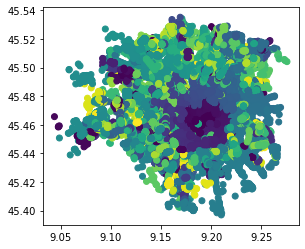

In [16]:
mappa_stradario_coordinate.plot(column="Sezione")

We can now visualise Milan's *Sezioni Elettorali*. Each dot represents an address and its colour indicates the respective *Sezione Elettorale*.

# Define an area for each address

We can now process this data to generate a [Voronoi diagram](https://en.wikipedia.org/wiki/Voronoi_diagram). For each point ***P*** in our dataset, the Voronoi diagram defines a polygon such that the points contained within it are closer to the point ***P*** than to any other point in our dataset. 

This allows us to tessellate the area of the municipality, avoiding empty spaces and making the map easier to read. 

### Data Cleanup

First of all, we need to check that all our addresses are within Milan's city limits. 

In [17]:
perimetro = pd.read_csv("/content/drive/MyDrive/mappa_dati_elettorali_milano/limiti_comune.csv", delimiter=",")
perimetro.head(5)

,AREA,the_geom,PERIMETER,COD_ISTAT,NOME,prov,COD_ISTAT1,Zone_omoge,ISTAT,Totale
0,732.50162,MULTIPOLYGON (((9.394785772169321 45.562121458...,17228.19861,15044,CAMBIAGO,MI,15044,Adda Martesana,0,0
1,815.20915,MULTIPOLYGON (((8.96744235916174 45.6085309540...,19061.58177,15181,RESCALDINA,MI,15181,Alto milanese,0,0
2,1296.75548,MULTIPOLYGON (((9.533166674123366 45.591745500...,24825.09493,15221,TREZZO SULL`ADDA,MI,15221,Adda Martesana,0,0
3,1772.21591,MULTIPOLYGON (((8.938931597876273 45.611034908...,31535.95058,15118,LEGNANO,MI,15118,Alto milanese,0,0
4,662.12313,MULTIPOLYGON (((9.094456119396103 45.603992017...,17416.98596,15213,SOLARO,MI,15213,Nord Ovest,0,0


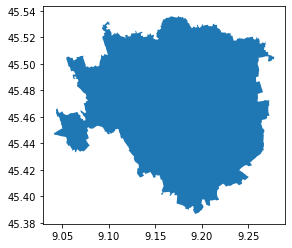

In [18]:
perimetro = perimetro[perimetro['NOME'] == 'MILANO']
perimetro['the_geom'] = perimetro['the_geom'].apply(wkt.loads)
perimetro = gpd.GeoDataFrame(perimetro, geometry='the_geom', crs='epsg:4326')
perimetro.plot()

In [70]:
stradario_within = gpd.sjoin(mappa_stradario_coordinate, perimetro, op = 'within')
stradario_within.drop(columns=['index_right','AREA','PERIMETER','COD_ISTAT','NOME','prov','COD_ISTAT1','Zone_omoge','ISTAT','Totale'], inplace = True)
stradario_within.reset_index(drop=True, inplace=True)
stradario_within

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:3249: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


,CodVia,Area,Via,Civico,Barrato,Sezione,Municipio,CollSen_UNI,CollCam_UNI,ID_NIL,NIL,LONG_WGS84,LAT_WGS84,geometry
0,4377,VIA,8 OTTOBRE 2001,12,0,916,4,3,8,32,TRIULZO SUPERIORE,9.252203,45.426219,POINT (9.25220 45.42622)
1,3123,VIA,A.DEL SARTO,1,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220296,45.471452,POINT (9.22030 45.47145)
2,3123,VIA,A.DEL SARTO,3,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220359,45.471479,POINT (9.22036 45.47148)
3,3123,VIA,A.DEL SARTO,4,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220472,45.471298,POINT (9.22047 45.47130)
4,3123,VIA,A.DEL SARTO,5,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220417,45.471504,POINT (9.22042 45.47150)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50666,6318,VIA,ZURIGO,24,0,394,7,3,8,56,FORZE ARMATE,9.117477,45.456672,POINT (9.11748 45.45667)
50667,6318,VIA,ZURIGO,24,4,394,7,3,8,56,FORZE ARMATE,9.117952,45.457412,POINT (9.11795 45.45741)
50668,6318,VIA,ZURIGO,25,0,1412,6,3,8,53,LORENTEGGIO,9.117660,45.456215,POINT (9.11766 45.45622)
50669,6318,VIA,ZURIGO,28,0,539,7,3,8,56,FORZE ARMATE,9.117033,45.456573,POINT (9.11703 45.45657)


In [71]:
stradario_within[['Sezione', 'geometry']].explore()

### Voronoi Diagram

In [20]:
%%capture
!pip install -U geovoronoi[plotting]

In [21]:
from geovoronoi import voronoi_regions_from_coords

In [22]:
area = perimetro.the_geom.iloc[0]

In [23]:
region_polys, region_pts = voronoi_regions_from_coords(stradario_within.geometry, area)

/usr/local/lib/python3.7/dist-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])
/usr/local/lib/python3.7/dist-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])


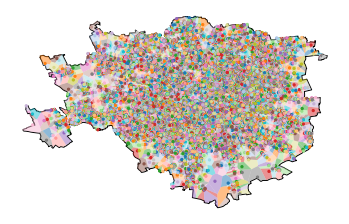

In [24]:
import matplotlib.pyplot as plt
from geovoronoi.plotting import subplot_for_map, plot_voronoi_polys_with_points_in_area

fig, ax = subplot_for_map()
plot_voronoi_polys_with_points_in_area(ax, area, region_polys, stradario_within.geometry, region_pts)
plt.show()

# Define the boundaries of each *Sezione Elettorale*

In [66]:
voronoi = zip([int(item[0]) for item in region_pts.values()], region_polys.values())

In [67]:
vor = pd.DataFrame(voronoi)
vor = vor.rename({0:'tmp_index', 1:'voronoi_poly'}, axis=1)
vor.head(5)

,tmp_index,voronoi_poly
0,40040,"POLYGON ((9.240898967550004 45.41559162046814,..."
1,28235,"POLYGON ((9.062410223220121 45.49812489398581,..."
2,28236,"POLYGON ((9.056421409880516 45.49885139380847,..."
3,40032,POLYGON ((9.241603259628247 45.416079582229536...
4,40038,POLYGON ((9.241406278489254 45.415587369716576...


In [68]:
vor = vor.set_index(['tmp_index'])
vor.sort_values(by='tmp_index', inplace=True)
vor.head(5)

,voronoi_poly
tmp_index,
0,POLYGON ((9.251782001905259 45.426406649607124...
1,POLYGON ((9.220270710001403 45.471593413042925...
2,POLYGON ((9.220290668068927 45.471613120002814...
3,POLYGON ((9.220428515253799 45.471396774962756...
4,"POLYGON ((9.22032489028328 45.47163797243683, ..."


In [79]:
mappa_sezioni = pd.merge(stradario_within, vor, left_index=True, right_index=True)
mappa_sezioni = mappa_sezioni.rename({0:'poly', 1:'voronoi_poly'}, axis=1)
mappa_sezioni

,CodVia,Area,Via,Civico,Barrato,Sezione,Municipio,CollSen_UNI,CollCam_UNI,ID_NIL,NIL,LONG_WGS84,LAT_WGS84,geometry,voronoi_poly
0,4377,VIA,8 OTTOBRE 2001,12,0,916,4,3,8,32,TRIULZO SUPERIORE,9.252203,45.426219,POINT (9.25220 45.42622),POLYGON ((9.251782001905259 45.426406649607124...
1,3123,VIA,A.DEL SARTO,1,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220296,45.471452,POINT (9.22030 45.47145),POLYGON ((9.220270710001403 45.471593413042925...
2,3123,VIA,A.DEL SARTO,3,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220359,45.471479,POINT (9.22036 45.47148),POLYGON ((9.220290668068927 45.471613120002814...
3,3123,VIA,A.DEL SARTO,4,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220472,45.471298,POINT (9.22047 45.47130),POLYGON ((9.220428515253799 45.471396774962756...
4,3123,VIA,A.DEL SARTO,5,0,665,3,3,7,21,BUENOS AIRES - PORTA VENEZIA - PORTA MONFORTE,9.220417,45.471504,POINT (9.22042 45.47150),"POLYGON ((9.22032489028328 45.47163797243683, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50666,6318,VIA,ZURIGO,24,0,394,7,3,8,56,FORZE ARMATE,9.117477,45.456672,POINT (9.11748 45.45667),"POLYGON ((9.117780852550338 45.45652858300088,..."
50667,6318,VIA,ZURIGO,24,4,394,7,3,8,56,FORZE ARMATE,9.117952,45.457412,POINT (9.11795 45.45741),POLYGON ((9.117628362113846 45.457097442502075...
50668,6318,VIA,ZURIGO,25,0,1412,6,3,8,53,LORENTEGGIO,9.117660,45.456215,POINT (9.11766 45.45622),"POLYGON ((9.117780852550338 45.45652858300088,..."
50669,6318,VIA,ZURIGO,28,0,539,7,3,8,56,FORZE ARMATE,9.117033,45.456573,POINT (9.11703 45.45657),"POLYGON ((9.117317285104491 45.45634346190087,..."


In [88]:
mappa_sezioni_joined = gpd.GeoDataFrame(mappa_sezioni, geometry='voronoi_poly', crs='epsg:4326')

In [89]:
mappa_sezioni_joined = mappa_sezioni_joined.dissolve(by='Sezione', aggfunc='sum')

In [93]:
mappa_sezioni_joined.explore(column="Sezione")

### Cleanup for export

In [91]:
mappa_sezioni_joined.head(5)

,voronoi_poly,CodVia,Civico,Municipio,CollSen_UNI,CollCam_UNI,ID_NIL,LONG_WGS84,LAT_WGS84
Sezione,,,,,,,,,
1,"MULTIPOLYGON (((9.19406 45.46294, 9.19404 45.4...",123384,1755,165,495,1485,255,1517.708365,7501.583251
2,"POLYGON ((9.14419 45.51770, 9.14425 45.51773, ...",74146,211,80,40,70,760,91.431082,455.179727
3,"MULTIPOLYGON (((9.13904 45.50931, 9.13815 45.5...",139401,312,152,76,133,1444,173.699825,864.716676
4,"POLYGON ((9.06717 45.44996, 9.06653 45.44995, ...",134843,90,140,60,160,1080,181.361639,909.040370
5,"POLYGON ((9.19156 45.45915, 9.19139 45.45932, ...",47461,914,110,330,990,131,1011.375380,5000.736859


In [92]:
mappa_sezioni_joined = gpd.GeoDataFrame(mappa_sezioni_joined, geometry='voronoi_poly', crs='epsg:4326')
mappa_sezioni_joined.reset_index(drop=False, inplace=True)
mappa_sezioni_joined.rename({'index':'sezione'}, axis=1)
mappa_sezioni_joined.head(5)

,Sezione,voronoi_poly,CodVia,Civico,Municipio,CollSen_UNI,CollCam_UNI,ID_NIL,LONG_WGS84,LAT_WGS84
0,1,"MULTIPOLYGON (((9.19406 45.46294, 9.19404 45.4...",123384,1755,165,495,1485,255,1517.708365,7501.583251
1,2,"POLYGON ((9.14419 45.51770, 9.14425 45.51773, ...",74146,211,80,40,70,760,91.431082,455.179727
2,3,"MULTIPOLYGON (((9.13904 45.50931, 9.13815 45.5...",139401,312,152,76,133,1444,173.699825,864.716676
3,4,"POLYGON ((9.06717 45.44996, 9.06653 45.44995, ...",134843,90,140,60,160,1080,181.361639,909.040370
4,5,"POLYGON ((9.19156 45.45915, 9.19139 45.45932, ...",47461,914,110,330,990,131,1011.375380,5000.736859


In [ ]:
!pip install folium matplotlib mapclassify

In [ ]:
sezioni_poly = mappa_sezioni_joined[['Sezione','voronoi_poly']].rename({'voronoi_poly':'geometry'}, axis = 1).set_geometry('geometry')
sezioni_poly

# Importing electoral data

### Senato

In [ ]:
senato_lis0 = pd.read_csv('/content/drive/MyDrive/mappa_dati_elettorali_milano/20220925_Voti_E2_C3.csv', delimiter=';')
senato_lis1 = pd.read_csv('/content/drive/MyDrive/mappa_dati_elettorali_milano/20220925_Voti_E2_C4.csv', delimiter=';')

In [ ]:
senato_lis = pd.concat([senato_lis0, senato_lis1])

In [ ]:
senato_lis.sort_values(by='Sezione', inplace=True)

In [94]:
senato_lis.head(5)

,Sezione,Elettori,Votanti,Validi,Non validi,Voti solo candidato uninominale,+EUROPA,IMPEGNO CIVICO LUIGI DI MAIO -,ALLEANZA VERDI E SINISTRA,PARTITO DEMOCRATICO - ITALIA D,MASTELLA NOI DI CENTRO EUROPEI,NOI MODERATI/LUPI - TOTI - BRU,LEGA PER SALVINI PREMIER,FRATELLI D'ITALIA CON GIORGIA,FORZA ITALIA,ITALIA SOVRANA E POPOLARE,MOVIMENTO 5 STELLE,ITALEXIT PER L'ITALIA,AZIONE - ITALIA VIVA - CALENDA,UNIONE POPOLARE CON DE MAGISTR,VITA
0,1,733,539,522,11,6,38,0,7,67,0,5,21,151,47,1,24,8,152,1,0
0,2,449,184,166,13,5,2,0,5,25,1,0,26,45,30,0,17,4,6,2,3
1,3,866,553,514,22,17,25,1,31,111,0,7,56,126,38,5,56,13,36,7,2
1,4,732,559,517,26,16,26,1,24,115,2,5,53,128,19,5,75,9,38,12,5
2,5,631,436,411,10,15,23,1,5,74,0,7,20,88,46,4,12,1,127,3,0


### Camera

In [ ]:
camera_lis0 = pd.read_csv('/content/drive/MyDrive/mappa_dati_elettorali_milano/20220925_Voti_E4_C7.csv', delimiter=';')
camera_lis1 = pd.read_csv('/content/drive/MyDrive/mappa_dati_elettorali_milano/20220925_Voti_E4_C8.csv', delimiter=';')
camera_lis2 = pd.read_csv('/content/drive/MyDrive/mappa_dati_elettorali_milano/20220925_Voti_E4_C9.csv', delimiter=';')

In [ ]:
camera_lis = pd.concat([camera_lis0, camera_lis1, camera_lis2])

In [ ]:
camera_lis.sort_values(by='Sezione', inplace=True)

In [95]:
camera_lis.head(5)

,Sezione,Elettori,Votanti,Validi,Non validi,Voti solo candidato uninominale,+EUROPA,IMPEGNO CIVICO LUIGI DI MAIO -,ALLEANZA VERDI E SINISTRA,PARTITO DEMOCRATICO - ITALIA D,MASTELLA NOI DI CENTRO EUROPEI,NOI MODERATI/LUPI - TOTI - BRU,LEGA PER SALVINI PREMIER,FRATELLI D'ITALIA CON GIORGIA,FORZA ITALIA,ITALIA SOVRANA E POPOLARE,MOVIMENTO 5 STELLE,ITALEXIT PER L'ITALIA,AZIONE - ITALIA VIVA - CALENDA,UNIONE POPOLARE CON DE MAGISTR,VITA
0,1,733,539,516,8,15,35,1,9,59,0,10,18,153,44,2,24,8,151,1,1
0,2,449,184,169,13,2,2,0,5,27,1,0,21,53,23,1,20,5,5,3,3
1,3,866,553,518,21,14,20,1,29,118,0,4,60,124,36,4,54,16,41,8,3
0,4,732,559,517,24,18,27,1,23,108,0,2,41,138,22,4,76,8,47,17,3
1,5,631,436,409,11,16,18,0,9,73,0,7,17,102,36,5,10,1,129,2,0


### Cleanup and merge

In [ ]:
senato_lis = senato_lis[[
 'Sezione',
 'Elettori',
 'Votanti',
 'Validi',
 'Non validi',
 'Voti solo candidato uninominale',
 '+EUROPA',
 'IMPEGNO CIVICO LUIGI DI MAIO -',
 'ALLEANZA VERDI E SINISTRA',
 'PARTITO DEMOCRATICO - ITALIA D',
 'MASTELLA NOI DI CENTRO EUROPEI',
 'NOI MODERATI/LUPI - TOTI - BRU',
 'LEGA PER SALVINI PREMIER',
 "FRATELLI D'ITALIA CON GIORGIA",
 'FORZA ITALIA',
 'ITALIA SOVRANA E POPOLARE',
 'MOVIMENTO 5 STELLE',
 "ITALEXIT PER L'ITALIA",
 'AZIONE - ITALIA VIVA - CALENDA',
 'UNIONE POPOLARE CON DE MAGISTR',
 'VITA']]
senato_lis

In [ ]:
camera_lis = camera_lis[[
 'Sezione',
 'Elettori',
 'Votanti',
 'Validi',
 'Non validi',
 'Voti solo candidato uninominale',
 '+EUROPA',
 'IMPEGNO CIVICO LUIGI DI MAIO -',
 'ALLEANZA VERDI E SINISTRA',
 'PARTITO DEMOCRATICO - ITALIA D',
 'MASTELLA NOI DI CENTRO EUROPEI',
 'NOI MODERATI/LUPI - TOTI - BRU',
 'LEGA PER SALVINI PREMIER',
 "FRATELLI D'ITALIA CON GIORGIA",
 'FORZA ITALIA',
 'ITALIA SOVRANA E POPOLARE',
 'MOVIMENTO 5 STELLE',
 "ITALEXIT PER L'ITALIA",
 'AZIONE - ITALIA VIVA - CALENDA',
 'UNIONE POPOLARE CON DE MAGISTR',
 'VITA']]
camera_lis

In [ ]:
dati_elettorali = camera_lis.merge(senato_lis, on="Sezione", suffixes=['_camera', '_senato'])
dati_elettorali

In [96]:
dati_elettorali.head(5)

,Sezione,Elettori_camera,Votanti_camera,Validi_camera,Non validi_camera,Voti solo candidato uninominale_camera,+EUROPA_camera,IMPEGNO CIVICO LUIGI DI MAIO -_camera,ALLEANZA VERDI E SINISTRA_camera,PARTITO DEMOCRATICO - ITALIA D_camera,MASTELLA NOI DI CENTRO EUROPEI_camera,NOI MODERATI/LUPI - TOTI - BRU_camera,LEGA PER SALVINI PREMIER_camera,FRATELLI D'ITALIA CON GIORGIA_camera,FORZA ITALIA_camera,ITALIA SOVRANA E POPOLARE_camera,MOVIMENTO 5 STELLE_camera,ITALEXIT PER L'ITALIA_camera,AZIONE - ITALIA VIVA - CALENDA_camera,UNIONE POPOLARE CON DE MAGISTR_camera,VITA_camera,Elettori_senato,Votanti_senato,Validi_senato,Non validi_senato,Voti solo candidato uninominale_senato,+EUROPA_senato,IMPEGNO CIVICO LUIGI DI MAIO -_senato,ALLEANZA VERDI E SINISTRA_senato,PARTITO DEMOCRATICO - ITALIA D_senato,MASTELLA NOI DI CENTRO EUROPEI_senato,NOI MODERATI/LUPI - TOTI - BRU_senato,LEGA PER SALVINI PREMIER_senato,FRATELLI D'ITALIA CON GIORGIA_senato,FORZA ITALIA_senato,ITALIA SOVRANA E POPOLARE_senato,MOVIMENTO 5 STELLE_senato,ITALEXIT PER L'ITALIA_senato,AZIONE - ITALIA VIVA - CALENDA_senato,UNIONE POPOLARE CON DE MAGISTR_senato,VITA_senato
0,1,733,539,516,8,15,35,1,9,59,0,10,18,153,44,2,24,8,151,1,1,733,539,522,11,6,38,0,7,67,0,5,21,151,47,1,24,8,152,1,0
1,2,449,184,169,13,2,2,0,5,27,1,0,21,53,23,1,20,5,5,3,3,449,184,166,13,5,2,0,5,25,1,0,26,45,30,0,17,4,6,2,3
2,3,866,553,518,21,14,20,1,29,118,0,4,60,124,36,4,54,16,41,8,3,866,553,514,22,17,25,1,31,111,0,7,56,126,38,5,56,13,36,7,2
3,4,732,559,517,24,18,27,1,23,108,0,2,41,138,22,4,76,8,47,17,3,732,559,517,26,16,26,1,24,115,2,5,53,128,19,5,75,9,38,12,5
4,5,631,436,409,11,16,18,0,9,73,0,7,17,102,36,5,10,1,129,2,0,631,436,411,10,15,23,1,5,74,0,7,20,88,46,4,12,1,127,3,0


# Joining electoral data with Sezione Elettorale data 

In [ ]:
mappa_out = dati_elettorali.merge(sezioni_poly, on='Sezione')

In [ ]:
mappa_out = gpd.GeoDataFrame(mappa_out, geometry='geometry', crs='epsg:4326')

In [ ]:
mappa_out.to_file("mappa_elezioni2022.geojson", driver='GeoJSON')